# Exploratory Data Analysis

This is a notebook exploring the data recieved from MUSIC weather station and spectral irradiance detectors. I investigate this data for the first time. Some data cleaning and simplest preprocessing is done. The aim of this notebook is just to take at what kind of data is measured by MUSIC equipment, compare it with extrenal data sources to verify correctens of acquired data. Also, it would be interestin to indentify some obvious trends and hallmarks. 

In [6]:
# Import all the libraries.

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

from plotly.offline import init_notebook_mode, iplot
from plotly import graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# Initialize plotly
init_notebook_mode(connected=True)

In [7]:
# Define a root direction to upload all csv files and merge them into one dataframe

root = r'..\Daily Summary files'
os.chdir(root)
files = os.listdir()

In [8]:
df = pd.DataFrame()
# Extract all data files into one dataframe
for file in files:
    new_file = pd.read_csv(file)
    df = pd.concat([df, new_file[1:]], sort = False)
df.tail(3)

,Timestamp,Elevation (deg),Azimuth (deg),WS600 Ambient Temperature (C),G-1 Ambient Temperature (C),G-2 Ambient Temperature (C),D2 Ambient Temperature (C),WS600 Ambient Pressure (kPa),G-1 Ambient Pressure (kPa),G-2 Ambient Pressure (kPa),...,O3 (DU),H2O (mm),AOD 368 nm,AOD 412 nm,AOD 500 nm,AOD 675 nm,AOD 862 nm,AOD 1024 nm,SMP21 DHI (W/m2),Unnamed: 35
1437,2019-12-17 23:57:00,-69.734,347.355,-2.7,-1.888,-2.138,-2.956,99.655,99.690,99.821,...,-1,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.607,NaN
1438,2019-12-17 23:58:00,-69.772,348.008,-2.7,-1.913,-2.163,-2.974,99.655,99.689,99.820,...,-1,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.615,NaN
1439,2019-12-17 23:59:00,-69.809,348.664,-2.7,-1.933,-2.178,-2.995,99.660,99.690,99.826,...,-1,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.600,NaN


In [9]:
# drop one of the accidentally made columns
df.drop(columns = ['Unnamed: 35'], inplace = True)

In [10]:
# let's save the dataframe, it could be useful in future
df.to_csv('..\Data\MUSIC_raw_df.csv')

In [11]:
# Take a look at general information about this data
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 235650 entries, 1 to 1439
Data columns (total 36 columns):
Timestamp                        235650 non-null object
Elevation (deg)                  235650 non-null float64
Azimuth (deg)                    235650 non-null float64
WS600 Ambient Temperature (C)    235650 non-null float64
G-1 Ambient Temperature (C)      235650 non-null float64
G-2 Ambient Temperature (C)      235650 non-null float64
D2 Ambient Temperature (C)       235650 non-null float64
WS600 Ambient Pressure (kPa)     235650 non-null float64
G-1 Ambient Pressure (kPa)       235650 non-null float64
G-2 Ambient Pressure (kPa)       235650 non-null float64
D2 Ambient Pressure (kPa)        235650 non-null float64
WS600 Ambient Humidity (%)       235650 non-null float64
G-1 Ambient Humidity (%)         235650 non-null float64
G-2 Ambient Humidity (%)         235650 non-null float64
WS600 Dew Point (C)              235650 non-null float64
WS600 Wind Speed (m/s)           2356

SMP21 - missing some values, O3 and has dtype object but must be float

In [12]:
# Change the dtype of Ozone column
df['O3 (DU)'] = df['O3 (DU)'].astype(float)

In [13]:
# Take a look at general information about this data
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Elevation (deg),235650.0,0.236845,34.276857,-70.080,-26.39000,0.658,26.65075,69.8330
Azimuth (deg),235650.0,179.849980,101.100066,0.001,89.74500,180.016,269.85050,359.9990
WS600 Ambient Temperature (C),235650.0,4.748729,273.247447,-7999.000,5.70000,16.000,21.80775,34.1000
G-1 Ambient Temperature (C),235650.0,15.607360,10.302733,-8.946,6.48200,17.249,23.71000,39.1380
G-2 Ambient Temperature (C),235650.0,15.687132,10.531538,-9.272,6.42025,17.212,23.82075,39.4720
D2 Ambient Temperature (C),235650.0,14.723327,50.597116,-7999.000,5.85200,16.532,23.06200,40.3440
WS600 Ambient Pressure (kPa),235650.0,90.827039,276.016905,-7999.000,99.83300,100.240,100.72600,102.3800
G-1 Ambient Pressure (kPa),235650.0,100.222750,0.703114,97.520,99.80100,100.220,100.71900,102.4380
G-2 Ambient Pressure (kPa),235650.0,100.368730,0.691947,98.091,99.94900,100.360,100.85500,102.5580
D2 Ambient Pressure (kPa),235650.0,99.902706,50.056774,-7999.000,99.81400,100.218,100.67700,102.2520


Some information about problematic features which need some cleaning:
* Temperature - WS600 Ambient Temperature (C), D2 Ambient Temperature (C) - min is too low - some outliers
* Pressure - Again data from WS600 and D2 have similar outliers
* WS600 - has negative outliers in all data
* All negative values from spectral irragiance data (G-1, G-2, SMP21, SHP1) does not make sense (it can not be negative)
* O3 and H2O also must be higher than 0

### Timestamp

Convert Timestamp column into pandas datetime format and make it an index column

In [14]:
df.Timestamp = pd.to_datetime(df.Timestamp)
df.set_index('Timestamp', inplace = True)
df.head(2)

,Elevation (deg),Azimuth (deg),WS600 Ambient Temperature (C),G-1 Ambient Temperature (C),G-2 Ambient Temperature (C),D2 Ambient Temperature (C),WS600 Ambient Pressure (kPa),G-1 Ambient Pressure (kPa),G-2 Ambient Pressure (kPa),D2 Ambient Pressure (kPa),...,SGR4 IR (W/m2),O3 (DU),H2O (mm),AOD 368 nm,AOD 412 nm,AOD 500 nm,AOD 675 nm,AOD 862 nm,AOD 1024 nm,SMP21 DHI (W/m2)
Timestamp,,,,,,,,,,,,,,,,,,,,,
2019-07-01 00:01:00,-23.418,354.374,16.7,17.485,17.267,15.754,100.3,100.302,100.429,100.320,...,324.375,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,NaN
2019-07-01 00:02:00,-23.436,354.624,16.7,17.478,17.253,15.746,100.3,100.302,100.429,100.322,...,324.487,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,NaN


Let's now take a look at each type of data separately and make 2 new datasets with hourly and daily info because dataset with the information every minute will be difficult analyze and fit

### Elevation and Azimuth (deg)

In [15]:
# creating a function for interactive plotting using plotly

def plotly_df(df, columns, title = ''):
    fig = go.Figure()
    for column in columns:
        fig.add_trace(go.Scatter(x=df.index, y=df[column], name=column))
    
    fig.update_layout(title_text=title,
                  xaxis_rangeslider_visible=True)
    #fig.show()
    iplot(fig)

In [16]:
# Create a function for plotting large datasets. If I use plotly_df to plot the full dataset the kernel shuts down.
# No such problem with matplotlib

def plot_large_df(df, columns, title = ''):
    plt.figure(figsize = (14, 7))
    for column in columns:
        plt.plot(df[column], label = column, alpha = 0.7)
    plt.title(title)
    plt.legend()
    plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\pylabtools.py:128: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



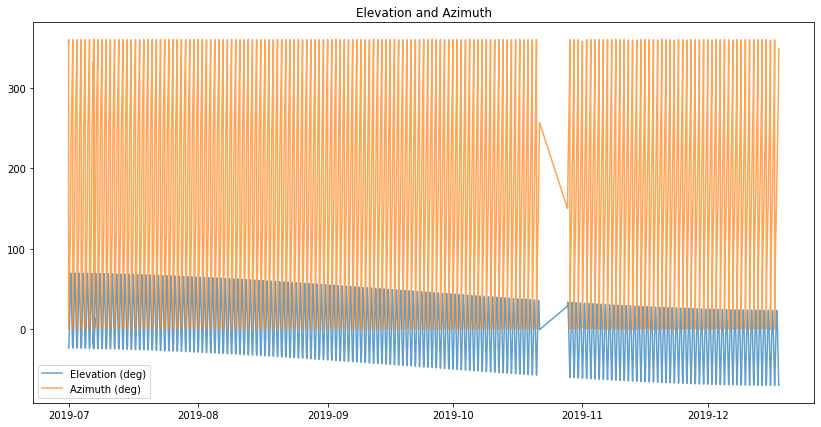

In [17]:
# Elevation and Azimuth column names
elev_azim_columns = ['Elevation (deg)', 'Azimuth (deg)']
plot_large_df(df, elev_azim_columns, 'Elevation and Azimuth')

Missing dates in the end of October

Let's start making two new dataframes with hourly and daily data.

In [18]:
# hourly - take mean from minutes data

hourly_df = df[elev_azim_columns].resample('H').mean()
hourly_df.head(3)

,Elevation (deg),Azimuth (deg)
Timestamp,,
2019-07-01 00:00:00,-23.488068,141.976271
2019-07-01 01:00:00,-21.797317,16.320183
2019-07-01 02:00:00,-17.488433,30.218567


In [19]:
hourly_df.columns = ['Elevation', 'Azimuth']

I think that in daily_df elevation and azimuth information will not be important.

### Temperature

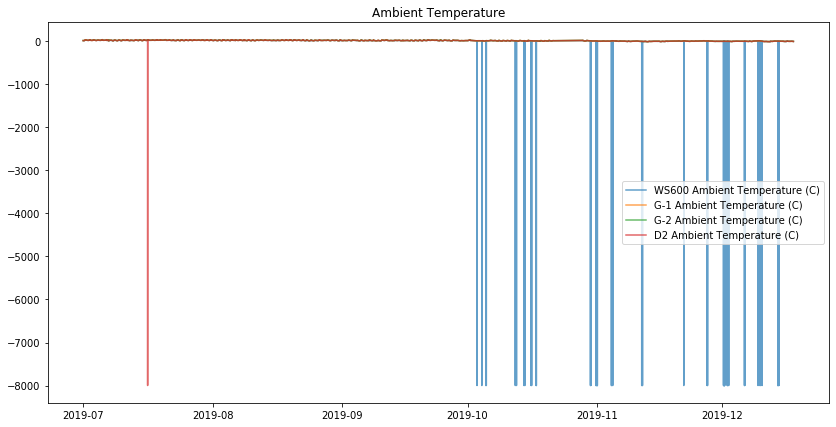

In [20]:
# Original names of columns with information about temperature
temperature_columns_origin = ['WS600 Ambient Temperature (C)', 'G-1 Ambient Temperature (C)', 'G-2 Ambient Temperature (C)',
                      'D2 Ambient Temperature (C)']
# New shorter names for the columns
temperature_columns = ['WS600 Temperature', 'G-1 Temperature', 'G-2 Temperature',
                      'D2 Temperature']

#plotly_df(df, temperature_columns_origin, 'Ambient Temperature')
plot_large_df(df, temperature_columns_origin, 'Ambient Temperature')

It can be seen that outliers take no more than several minutes. I assume the short outliers can be safely deleted without any negative effect on hourly and daily datasets.

All outliers have similar amplitude, I will just delete datapoints which have values lower than - 50.

In [21]:
# Resample the data to hourly time scale neglecting outliers.
hourly_df[temperature_columns] = df[df[temperature_columns_origin] > -50][temperature_columns_origin].resample('H').mean()
hourly_df.head(3)

,Elevation,Azimuth,WS600 Temperature,G-1 Temperature,G-2 Temperature,D2 Temperature
Timestamp,,,,,,
2019-07-01 00:00:00,-23.488068,141.976271,17.107288,17.337169,17.082237,15.530475
2019-07-01 01:00:00,-21.797317,16.320183,16.515650,16.951733,16.658500,15.033817
2019-07-01 02:00:00,-17.488433,30.218567,15.404467,15.996217,15.733067,14.166300


In [22]:
plotly_df(hourly_df, temperature_columns, 'Hourly Ambient Temperature')

In [23]:
# I have found an external dataset from local weather station to compare it with MUSIC temperatures
# Prepare the external dataset (df_ext)
df_ext = pd.read_excel('..\Data\external data.xls', usecols = [0, 1], skiprows = range(6))
df_ext.head(5)

,Local time in Hamilton (airport),T
0,17.12.2019 23:00,-4.0
1,17.12.2019 22:00,-4.0
2,17.12.2019 21:00,-4.0
3,17.12.2019 20:00,-4.0
4,17.12.2019 19:00,-2.0


In [24]:
df_ext.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4709 entries, 0 to 4708
Data columns (total 2 columns):
Local time in Hamilton (airport)    4709 non-null object
T                                   4706 non-null float64
dtypes: float64(1), object(1)
memory usage: 73.7+ KB


In [25]:
from datetime import datetime
# convert the column with time and date into datetime type
date_times = [datetime.strptime(df_ext['Local time in Hamilton (airport)'][i], '%d.%m.%Y %H:%M')
              for i in range(df_ext.shape[0])]

In [26]:
# create a new column with proper datetime
df_ext['time'] = date_times
df_ext.tail(3)

,Local time in Hamilton (airport),T,time
4706,01.07.2019 02:00,15.0,2019-07-01 02:00:00
4707,01.07.2019 01:00,16.0,2019-07-01 01:00:00
4708,01.07.2019 00:00,16.0,2019-07-01 00:00:00


In [27]:
# Delete the old column with dates and time, and reverse the dataset
df_ext.set_index('time', inplace = True)
df_ext.drop(columns = ['Local time in Hamilton (airport)'], inplace = True)
df_ext = df_ext.iloc[::-1]
df_ext.tail(2)

,T
time,
2019-12-17 22:00:00,-4.0
2019-12-17 23:00:00,-4.0


In [28]:
# PLot external data
plotly_df(df_ext, ['T'], 'Temperature from weather station')

In [29]:
# Add external temperature data into hourly_df dataframe
hourly_df['External Temperature'] = df_ext['T']
hourly_df.head(5)

,Elevation,Azimuth,WS600 Temperature,G-1 Temperature,G-2 Temperature,D2 Temperature,External Temperature
Timestamp,,,,,,,
2019-07-01 00:00:00,-23.488068,141.976271,17.107288,17.337169,17.082237,15.530475,16.0
2019-07-01 01:00:00,-21.797317,16.320183,16.515650,16.951733,16.658500,15.033817,16.0
2019-07-01 02:00:00,-17.488433,30.218567,15.404467,15.996217,15.733067,14.166300,15.0
2019-07-01 03:00:00,-11.002600,42.774283,14.706733,15.211167,14.910633,13.333933,15.0
2019-07-01 04:00:00,-2.514850,53.987317,13.968317,14.452283,14.151783,12.531150,13.0


In [30]:
# Name columns
temperature_columns = hourly_df.columns[2:7]
temperature_columns

Index(['WS600 Temperature', 'G-1 Temperature', 'G-2 Temperature',
       'D2 Temperature', 'External Temperature'],
      dtype='object')

In [31]:
# Plot all temperature data
plotly_df(hourly_df, temperature_columns, 'Ambient Temperature')

In [32]:
# Create a dataframe with average daily temperature
daily_df = hourly_df[['WS600 Temperature', 'External Temperature']].resample('D').mean()

daily_df.head(2)

,WS600 Temperature,External Temperature
Timestamp,,
2019-07-01,22.519209,20.916667
2019-07-02,23.468848,21.958333


In [33]:
plotly_df(daily_df, ['WS600 Temperature', 'External Temperature'], 'Daily Temperature')

External data and MUSIC data match

### Ambient Pressure

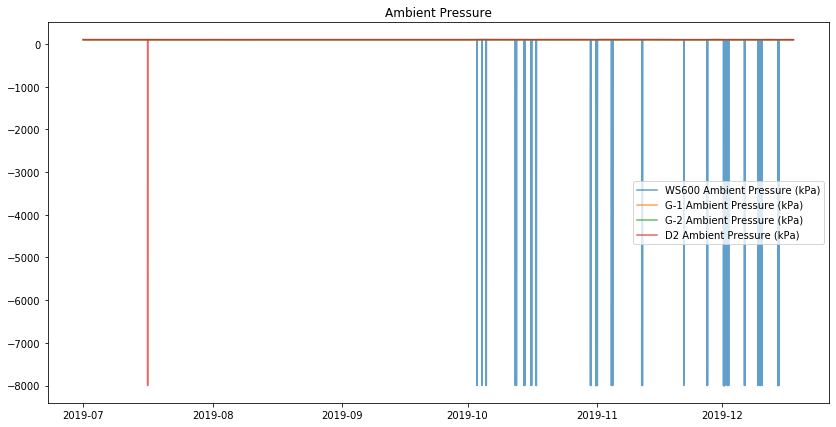

In [34]:
# Original names of columns with information about pressure
pressure_columns_origin = ['WS600 Ambient Pressure (kPa)', 'G-1 Ambient Pressure (kPa)', 'G-2 Ambient Pressure (kPa)',
                      'D2 Ambient Pressure (kPa)']
# New shorter names for the columns
pressure_columns = ['WS600 Pressure', 'G-1 Pressure', 'G-2 Pressure',
                      'D2 Pressure']

#plotly_df(df, pressure_columns_origin, 'Ambient Pressure')
plot_large_df(df, pressure_columns_origin, 'Ambient Pressure')

In [35]:
# resample time series neglecting outliers
hourly_df[pressure_columns] = df[df[pressure_columns_origin] > 0][pressure_columns_origin].resample('H').mean()
hourly_df.head(3)

,Elevation,Azimuth,WS600 Temperature,G-1 Temperature,G-2 Temperature,D2 Temperature,External Temperature,WS600 Pressure,G-1 Pressure,G-2 Pressure,D2 Pressure
Timestamp,,,,,,,,,,,
2019-07-01 00:00:00,-23.488068,141.976271,17.107288,17.337169,17.082237,15.530475,16.0,100.302220,100.305288,100.428068,100.320983
2019-07-01 01:00:00,-21.797317,16.320183,16.515650,16.951733,16.658500,15.033817,16.0,100.269017,100.272133,100.395467,100.283050
2019-07-01 02:00:00,-17.488433,30.218567,15.404467,15.996217,15.733067,14.166300,15.0,100.217517,100.227017,100.350833,100.231767


In [36]:
plotly_df(hourly_df, pressure_columns, 'Ambient Pressure')

Let's upload a full external dataset into one dataframe

In [37]:
df_ext = pd.read_excel('..\Data\external data.xls', skiprows = range(6))
df_ext.head(2)

,Local time in Hamilton (airport),T,P0,P,U,DD,Ff,ff10,WW,W'W',c,VV,Td
0,17.12.2019 23:00,-4.0,735.2,757.7,74.0,Wind blowing from the south-west,5,NaN,NaN,NaN,Broken clouds (60-90%) 1080 m,16.0,-8.0
1,17.12.2019 22:00,-4.0,735.3,757.9,74.0,Wind blowing from the south-west,5,NaN,NaN,NaN,"Broken clouds (60-90%) 1020 m, broken clouds (...",16.0,-8.0


In [38]:
# Do the same steps as for temperature. But this time for the hall external dataset
date_times = [datetime.strptime(df_ext['Local time in Hamilton (airport)'][i], '%d.%m.%Y %H:%M')
              for i in range(df_ext.shape[0])]

df_ext['time'] = date_times
df_ext.set_index('time', inplace = True)
df_ext.drop(columns = ['Local time in Hamilton (airport)'], inplace = True)
df_ext = df_ext.iloc[::-1]
df_ext.tail(2)

,T,P0,P,U,DD,Ff,ff10,WW,W'W',c,VV,Td
time,,,,,,,,,,,,
2019-12-17 22:00:00,-4.0,735.3,757.9,74.0,Wind blowing from the south-west,5,NaN,NaN,NaN,"Broken clouds (60-90%) 1020 m, broken clouds (...",16.0,-8.0
2019-12-17 23:00:00,-4.0,735.2,757.7,74.0,Wind blowing from the south-west,5,NaN,NaN,NaN,Broken clouds (60-90%) 1080 m,16.0,-8.0


In [39]:
df_ext.columns

Index(['T', 'P0', 'P', 'U', 'DD', 'Ff', 'ff10', 'WW', 'W'W'', 'c', 'VV', 'Td'], dtype='object')

In [40]:
# Convert mm to Pa
df_ext['P0'] = df_ext['P0'].values / 760 * 101.325
df_ext['P'] = df_ext['P'].values / 760 * 101.325
df_ext.head(2)

,T,P0,P,U,DD,Ff,ff10,WW,W'W',c,VV,Td
time,,,,,,,,,,,,
2019-07-01 00:00:00,16.0,98.885201,101.698303,77.0,Wind blowing from the north,2,NaN,NaN,NaN,Few clouds (10-30%) 7500 m,16.0,12.0
2019-07-01 01:00:00,16.0,98.885201,101.698303,77.0,Wind blowing from the north,2,NaN,NaN,NaN,Few clouds (10-30%) 7500 m,16.0,12.0


In [41]:
plotly_df(df_ext, ['P', 'P0'], 'External Ambient Pressure')

In [42]:
hourly_df['External Pressure'] = df_ext['P0']

pressure_columns.append('External Pressure')

In [43]:
plotly_df(hourly_df, pressure_columns, 'Ambient Pressure')

External Pressure is slightly differetn from MUSIC data because the position of external wearher station seems to be higher.

In [44]:
# Resample to daily scale. Calculate the average pressure during the day.
daily_pressure_columns = ['WS600 pressure', 'External Pressure']
daily_df[daily_pressure_columns] = hourly_df[['WS600 Pressure', 'External Pressure']].resample('D').mean()
daily_df.head(2)

plotly_df(daily_df, daily_pressure_columns, 'Ambient Pressure (Daily Average)')

### Humidity

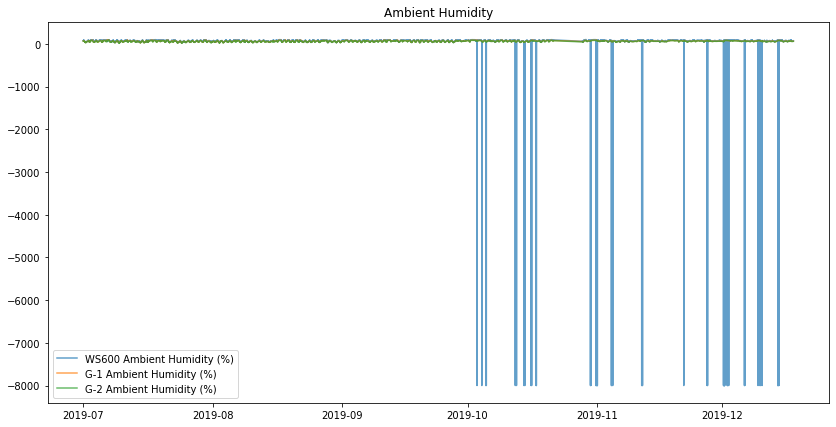

In [45]:
# Original names of columns with information about pressure
humidity_columns_origin = ['WS600 Ambient Humidity (%)','G-1 Ambient Humidity (%)', 'G-2 Ambient Humidity (%)']
# New shorter names for the columns
humidity_columns = ['WS600 Humidity','G-1 Humidity', 'G-2 Humidity']

#plotly_df(df, pressure_columns_origin, 'Ambient Pressure')
plot_large_df(df, humidity_columns_origin, 'Ambient Humidity')

WS600 seems to have outliers again

In [46]:
# Resample
hourly_df[humidity_columns] = df[df[humidity_columns_origin] > 0][humidity_columns_origin].resample('H').mean()
hourly_df.head(3)

,Elevation,Azimuth,WS600 Temperature,G-1 Temperature,G-2 Temperature,D2 Temperature,External Temperature,WS600 Pressure,G-1 Pressure,G-2 Pressure,D2 Pressure,External Pressure,WS600 Humidity,G-1 Humidity,G-2 Humidity
Timestamp,,,,,,,,,,,,,,,
2019-07-01 00:00:00,-23.488068,141.976271,17.107288,17.337169,17.082237,15.530475,16.0,100.302220,100.305288,100.428068,100.320983,98.885201,73.348593,67.142763,63.503814
2019-07-01 01:00:00,-21.797317,16.320183,16.515650,16.951733,16.658500,15.033817,16.0,100.269017,100.272133,100.395467,100.283050,98.885201,75.396117,68.469267,64.775233
2019-07-01 02:00:00,-17.488433,30.218567,15.404467,15.996217,15.733067,14.166300,15.0,100.217517,100.227017,100.350833,100.231767,98.805207,79.604983,71.265717,67.343300


In [47]:
plotly_df(hourly_df, humidity_columns, 'Ambient Humidity')

In [48]:
hourly_df['External Humidity'] = df_ext['U']
humidity_columns.append('External Humidity')
plotly_df(hourly_df, humidity_columns, 'Ambient Humidity')

Humidity is much higher at night.

In [50]:
# Resample to daily scale. Calculate the average humidity during the day.
daily_humidity_columns = ['WS600 Humidity', 'External Humidity']
daily_df[daily_humidity_columns] = hourly_df[['WS600 Humidity', 'External Humidity']].resample('D').mean()
daily_df.head(2)

plotly_df(daily_df, daily_humidity_columns, 'Ambient Humidity (Daily Average)')

External data is relatively close to the MUSIC data

### Dew Point

In [51]:
dew_point_columns = ['WS600 Dew Point (C)']

hourly_df['Dew Point'] = df[df[dew_point_columns] > -50][dew_point_columns].resample('H').mean()

hourly_df['External Dew Point'] = df_ext['Td']

dew_point_cols = ['Dew Point', 'External Dew Point']

hourly_df.head(1)

,Elevation,Azimuth,WS600 Temperature,G-1 Temperature,G-2 Temperature,D2 Temperature,External Temperature,WS600 Pressure,G-1 Pressure,G-2 Pressure,D2 Pressure,External Pressure,WS600 Humidity,G-1 Humidity,G-2 Humidity,External Humidity,Dew Point,External Dew Point
Timestamp,,,,,,,,,,,,,,,,,,
2019-07-01,-23.488068,141.976271,17.107288,17.337169,17.082237,15.530475,16.0,100.30222,100.305288,100.428068,100.320983,98.885201,73.348593,67.142763,63.503814,77.0,12.281932,12.0


In [52]:
plotly_df(hourly_df, dew_point_cols, 'Dew Point')

In [53]:
# Daily average 

daily_dewpoint_columns = ['Dew Point', 'External Dew Point']
daily_df[daily_dewpoint_columns] = hourly_df[['Dew Point', 'External Dew Point']].resample('D').mean()
daily_df.head(2)

plotly_df(daily_df, daily_dewpoint_columns, 'Dew Point (Daily Average)')

### Wind Speed

In [58]:
wind_speed_columns = ['WS600 Wind Speed (m/s)']

hourly_df['Wind Speed'] = df[(df[wind_speed_columns] > 0) & (df[wind_speed_columns] < 100)][wind_speed_columns].resample('H').mean()
hourly_df['External Wind Speed'] = df_ext['Ff'] # Wind Speed from external dataset

wind_speed_cols = ['Wind Speed', 'External Wind Speed']

plotly_df(hourly_df, wind_speed_cols, 'Wind Speed')

Wind speed values from the external dataset are higher because it measures wind speed at higher heght. But both datasets correlate with each other. 

It can also be seen that wind speed has a periodical nature. It is usually stronger close to the midday and weaker during the nights.

In [59]:
# Daily Wind Speed

daily_windspeed_columns = ['Wind Speed', 'External Wind Speed']
daily_df[daily_windspeed_columns] = hourly_df[['Wind Speed', 'External Wind Speed']].resample('D').mean()
daily_df.head(2)

plotly_df(daily_df, daily_windspeed_columns, 'Wind Speed (Daily Average)')

### Precipitation

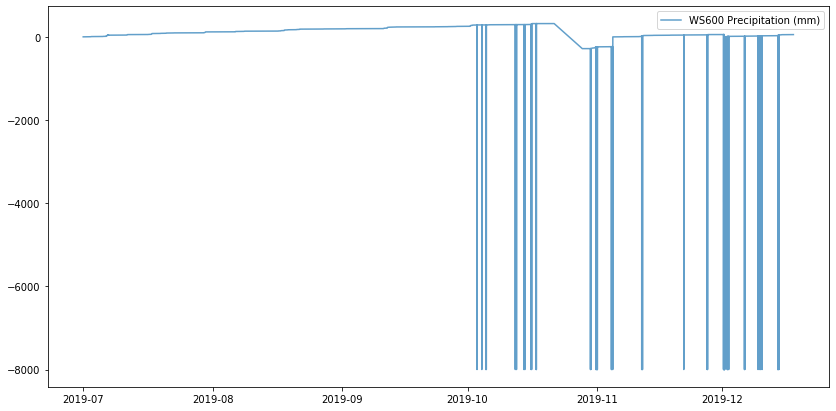

In [60]:
plot_large_df(df, ['WS600 Precipitation (mm)'])

Many outliers in preciptation data. It seems that the data was accumulated duting some time and then at some point of time (in the end of October) the precipitation counter was zeroed. After that, it started to accumulate the data again. This mean that little bit more sophisticated approach is needed to accurately analyze the data.

In [61]:
# Precipitation data prerpocessing
precipitation = []

prev = df['WS600 Precipitation (mm)'].values[0]
for i in df['WS600 Precipitation (mm)'].values:
    if i < 0:
        i = prev
    elif i - prev < 0 :
        prev = 0
    elif i - prev < 0.1:
        i = prev
    precipitation.append(i - prev)
    prev = i

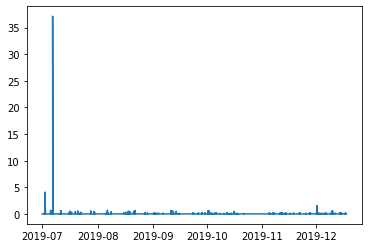

In [62]:
plt.plot(df.index, precipitation)

In [63]:
df['Proper Precipitation'] = precipitation

df.head(1)

,Elevation (deg),Azimuth (deg),WS600 Ambient Temperature (C),G-1 Ambient Temperature (C),G-2 Ambient Temperature (C),D2 Ambient Temperature (C),WS600 Ambient Pressure (kPa),G-1 Ambient Pressure (kPa),G-2 Ambient Pressure (kPa),D2 Ambient Pressure (kPa),...,O3 (DU),H2O (mm),AOD 368 nm,AOD 412 nm,AOD 500 nm,AOD 675 nm,AOD 862 nm,AOD 1024 nm,SMP21 DHI (W/m2),Proper Precipitation
Timestamp,,,,,,,,,,,,,,,,,,,,,
2019-07-01 00:01:00,-23.418,354.374,16.7,17.485,17.267,15.754,100.3,100.302,100.429,100.32,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,NaN,0.0


In [64]:
df['WS600 Precipitation (mm)'].describe()

count    235650.000000
mean        108.860127
std         304.028403
min       -7999.000000
25%          42.260000
50%         120.370000
75%         199.540000
max         320.920000
Name: WS600 Precipitation (mm), dtype: float64

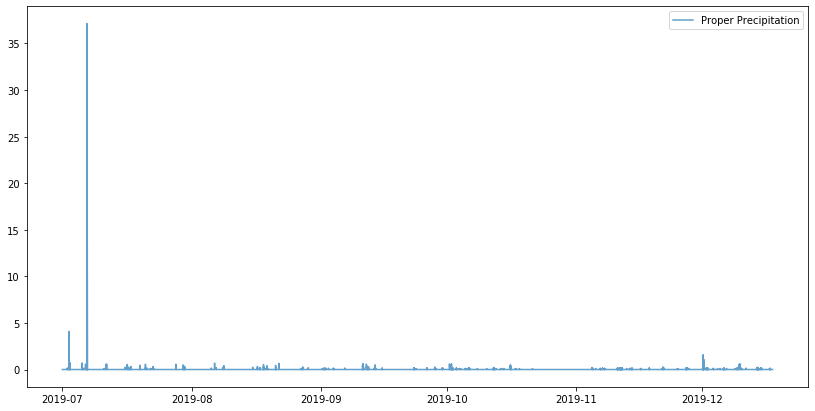

In [86]:
plot_large_df(df, ['Proper Precipitation'])

In [65]:
precipitation_column = ['Proper Precipitation']

hourly_df['Precipitation'] = df[precipitation_column].resample('H', label = 'right', closed = 'right').mean()*60

#hourly_df['Precipitation'][hourly_df['Precipitation'] < 1] = 0

precip_cols = ['Precipitation']

plotly_df(hourly_df, precip_cols, 'Hourly Precipitation')

In [66]:
daily_df['Precipitation'] = hourly_df['Precipitation'].resample('D').mean()*24

daily_df.head(1)

,WS600 Temperature,External Temperature,WS600 pressure,External Pressure,WS600 Humidity,External Humidity,Dew Point,External Dew Point,Wind Speed,External Wind Speed,Precipitation
Timestamp,,,,,,,,,,,
2019-07-01,22.519209,20.916667,100.086614,98.742435,58.050552,71.208333,13.282531,15.291667,1.559637,3.166667,0.0


In [67]:
plotly_df(daily_df, precip_cols, 'Daily Average Precipitation (mm)')

External precipitation data was not found

### Precipitation Type

In [68]:
df.columns

Index(['Elevation (deg)', 'Azimuth (deg)', 'WS600 Ambient Temperature (C)',
       'G-1 Ambient Temperature (C)', 'G-2 Ambient Temperature (C)',
       'D2 Ambient Temperature (C)', 'WS600 Ambient Pressure (kPa)',
       'G-1 Ambient Pressure (kPa)', 'G-2 Ambient Pressure (kPa)',
       'D2 Ambient Pressure (kPa)', 'WS600 Ambient Humidity (%)',
       'G-1 Ambient Humidity (%)', 'G-2 Ambient Humidity (%)',
       'WS600 Dew Point (C)', 'WS600 Wind Speed (m/s)',
       'WS600 Wind Direction (deg)', 'WS600 Precipitation (mm)',
       'WS600 Precipitation Type', 'SMP21 GHI (W/m2)', 'G-1 GHI (W/m2)',
       'SMP21 DHI(W/m2)', 'SHP1 DNI (W/m2)', 'D2 DNI (W/m2)',
       'SMP21 GTI (W/m2)', 'G-2 GTI (W/m2)', 'SGR4 IR (W/m2)', 'O3 (DU)',
       'H2O (mm)', 'AOD 368 nm', 'AOD 412 nm', 'AOD 500 nm', 'AOD 675 nm',
       'AOD 862 nm', 'AOD 1024 nm', 'SMP21 DHI (W/m2)',
       'Proper Precipitation'],
      dtype='object')

In [69]:
df['WS600 Precipitation Type'].describe()

count     235650.0
unique       186.0
top            0.0
freq      211631.0
Name: WS600 Precipitation Type, dtype: float64

In [70]:
df['WS600 Precipitation Type'].unique()

array([0, 46, 60, 57, 17, 41, 50, 27, 13, 33, 36, 31, 44, 16, 12, 26, 47,
       4, 1, 5, 49, 55, 23, 35, 38, 14, 25, 59, 58, 34, 52, 37, 7, 6, 54,
       11, 56, 10, 15, 8, 45, 24, 43, 40, 29, 22, 9, 39, 28, 20, 53, 21,
       42, 19, 32, 18, 51, 2, 30, 48, 3, -7999, 61.833, 60.667, 65.5,
       70.0, 67.5, 64.667, 67.0, 63.333, 61.667, 62.333, 64.167, 69.167,
       63.833, 61.333, 65.167, 62.833, 60.833, 63.5, 68.667, 69.667,
       4.667, 63.167, 68.5, 66.667, 62.0, 50.667, 68.0, 16.333, 20.167,
       65.0, 69.833, 51.333, 50.167, 44.333, 65.667, 61.5, 67.333, 69.333,
       61.167, 60.5, 61.0, 60.333, 63.0, 66.333, 62.167, 69.0, 63.667,
       62.5, 68.333, 65.333, 9.333, 52.667, 64.833, 66.5, 67.667, 45.667,
       44.5, 64.0, 62.667, 60.167, 66.833, 69.5, 67.167, 33.833, 54.333,
       66.167, 46.667, 52.5, 29.166999999999998, 5.832999999999999, 66.0,
       67.833, 64.333, 68.167, 65.833, 68.833, 54.833, 58.333, 15.167,
       36.167, 39.667, 64.5, 27.5, 18.667, 43.167, 49.5, 

In [75]:
df['WS600 Precipitation Type'].isnull().values.any()

False

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\pylabtools.py:128: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



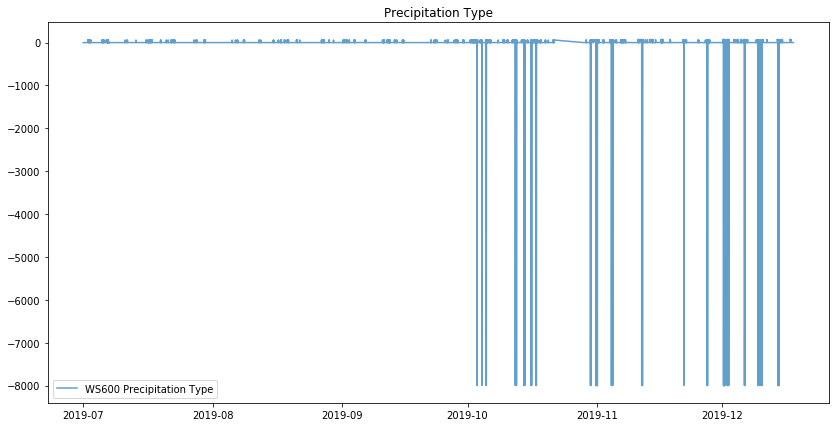

In [71]:
plot_large_df(df, ['WS600 Precipitation Type'], 'Precipitation Type')

In [74]:
# Get rid of obvious outliers and resample the data
precipitation_type_columns = ['WS600 Precipitation Type']

hourly_df['Precipitation Type'] = df[df[precipitation_type_columns] > 0][precipitation_type_columns].astype('float').resample('H').mean()

precip_type_cols = ['Precipitation Type']

plotly_df(hourly_df, precip_type_cols, 'Precipitation')

It is hard to say how the system calculated the precipitation type and what is the logic behind these numbers. Therefore, Precipitation Type will not be counted in the fututre.

## Solar Data

Here we start analyzing data from spectral detectors

### Global Horizontal Irradiance (GHI) - SMP21, G-1

Global Horizontal Irradiance (GHI) is the total irradiance from the sun on a horizontal surface on Earth. It is the sum of direct irradiance (after accounting for the solar zenith angle of the sun z) and diffuse horizontal irradiance.

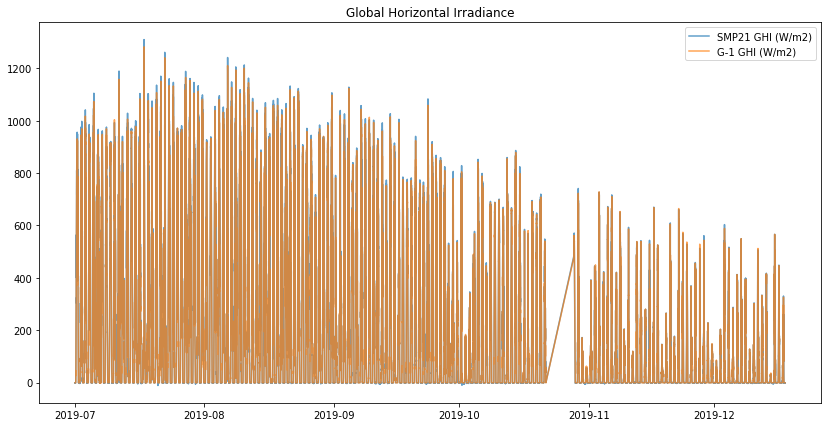

In [76]:
ghi_columns = ['SMP21 GHI (W/m2)', 'G-1 GHI (W/m2)']

plot_large_df(df, ghi_columns, 'Global Horizontal Irradiance')

In [77]:
ghi_columns_orig = ['SMP21 GHI (W/m2)', 'G-1 GHI (W/m2)']

ghi_columns = ['SMP21 GHI', 'G-1 GHI']

df['SMP21 GHI (W/m2)'] = [0 if i < 0 else i for i in df['SMP21 GHI (W/m2)'].values]
df['G-1 GHI (W/m2)'] = [0 if i < 0 else i for i in df['G-1 GHI (W/m2)'].values]

hourly_df[ghi_columns] = df[ghi_columns_orig].resample('H').mean()

plotly_df(hourly_df, ghi_columns, 'Global Horizontal Irradiance (W/m2)')

In [78]:
# Daily GHI 

daily_df[['SMP21 GHI max', 'G-1 GHI max']] = hourly_df[ghi_columns].resample('D').max()
daily_df[['SMP21 GHI mean', 'G-1 GHI mean']] = hourly_df[ghi_columns].resample('D').mean()

daily_ghi_columns = ['SMP21 GHI max', 'G-1 GHI max', 'SMP21 GHI mean', 'G-1 GHI mean']

plotly_df(daily_df, daily_ghi_columns, 'Daily GHI')

The data has to be further investigates. There some potential outliers which must be verified using statistical methods and common sense. Can the irradience drop to values lower than 100 w/m^2 during the day?

### Diffusd Horizontal Irradiance (DHI) - SMP21

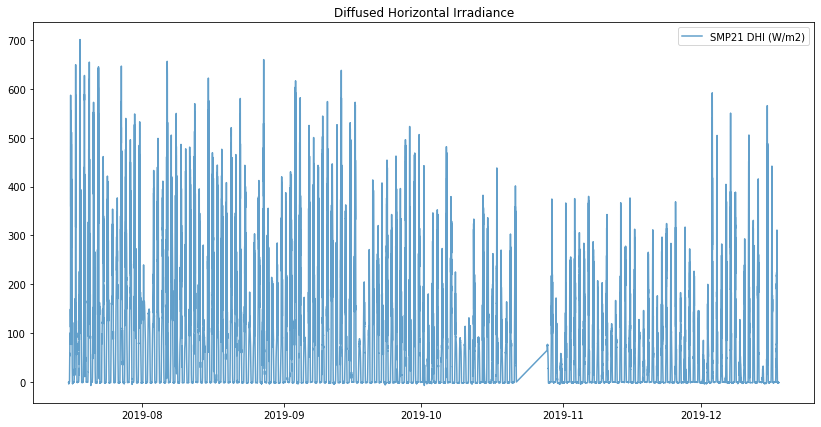

In [79]:
dhi_columns = ['SMP21 DHI (W/m2)']

plot_large_df(df, dhi_columns, 'Diffused Horizontal Irradiance')

In [80]:
# Hourly DHI

dhi_columns_orig = ['SMP21 DHI (W/m2)']

dhi_columns = ['SMP21 DHI']

df['SMP21 DHI (W/m2)'] = [0 if i < 0 else i for i in df['SMP21 DHI (W/m2)'].values]

hourly_df[dhi_columns] = df[dhi_columns_orig].resample('H').mean()

plotly_df(hourly_df, dhi_columns, 'Diffused Horizontal Irradiance (W/m2)')

In [100]:
# Daily DHI

daily_df['SMP21 DHI max'] = hourly_df[dhi_columns].resample('D').max()
daily_df['SMP21 DHI mean'] = hourly_df[dhi_columns].resample('D').mean()

daily_dhi_columns = ['SMP21 DHI max', 'SMP21 DHI mean']

plotly_df(daily_df, daily_dhi_columns, 'Daily DHI')

Further outlier analysis is needed.

### Direct Normal Irradience

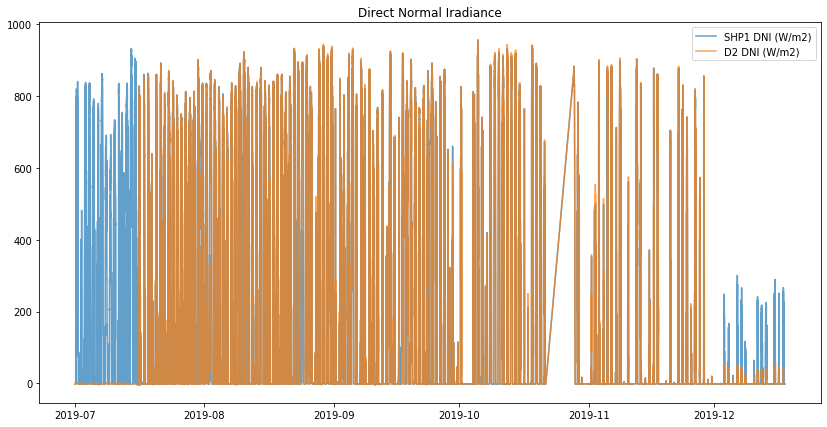

In [81]:
plot_large_df(df, ['SHP1 DNI (W/m2)', 'D2 DNI (W/m2)'], 'Direct Normal Iradiance')

In [82]:
# Hourly DNI

dni_columns_orig = ['SHP1 DNI (W/m2)', 'D2 DNI (W/m2)']
dni_columns = ['SHP1 DNI', 'D2 DNI']

df['SHP1 DNI (W/m2)'] = [0 if i < 0 else i for i in df['SHP1 DNI (W/m2)'].values]
df['D2 DNI (W/m2)'] = [0 if i < 0 else i for i in df['D2 DNI (W/m2)'].values]

hourly_df[dni_columns] = df[dni_columns_orig].resample('H').mean()

plotly_df(hourly_df, dni_columns, 'Direct Normal Irradiance (W/m2)')

In [83]:
# Daily DNI 

daily_df[['SHP1 DNI max', 'D2 DNI max']] = hourly_df[dni_columns].resample('D').max()
daily_df[['SHP1 DNI mean', 'D2 DNI mean']] = hourly_df[dni_columns].resample('D').mean()

daily_dni_columns = ['SHP1 DNI max', 'D2 DNI max', 'SHP1 DNI mean', 'D2 DNI mean']

plotly_df(daily_df, daily_dni_columns, 'Daily DNI')

It can be seen that something went wrong with the data after November 30. On October, 30 there was an electrical shut down. Probably the shut down caused some mulfunctions in the equipment because the number of outliers and drops considerably increased. Also, something happend on November, 30. D2 data dropped alsmost to 0, while SHP1 data also shows much lower numbers than expected.

I assume that the data after November 30 can not be trusted and the data in November must be carefully analyzed.

### Global Tilted Irradiance

Global Tilted Irradiation/Irradiance (GTI), or total radiation received on a surface with defined tilt and azimuth, fixed or sun-tracking. This is the sum of the scattered radiation, direct and reflected. It is a reference for photovoltaic (PV) applications, and can be occasionally affected by shadow.

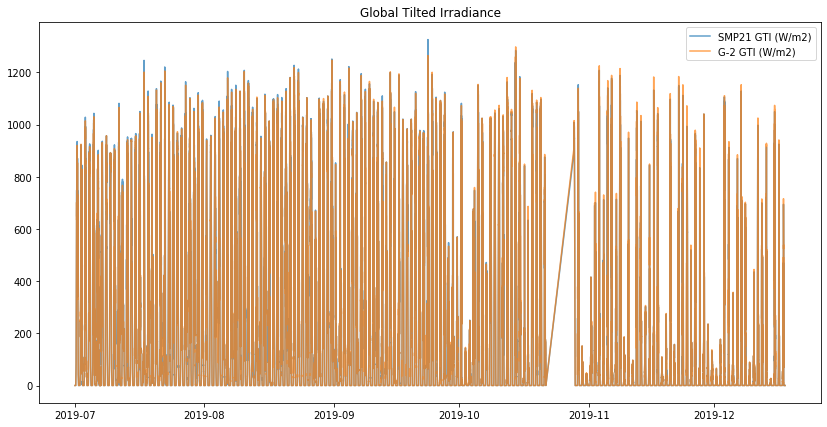

In [87]:
gti_columns_orig = ['SMP21 GTI (W/m2)', 'G-2 GTI (W/m2)']
gti_columns = ['SMP21 GTI', 'G-2 GTI']

plot_large_df(df, gti_columns_orig, 'Global Tilted Irradiance')

In [88]:
df['SMP21 GTI (W/m2)'] = [0 if i < 0 else i for i in df['SMP21 GTI (W/m2)'].values]
df['G-2 GTI (W/m2)'] = [0 if i < 0 else i for i in df['G-2 GTI (W/m2)'].values]

hourly_df[gti_columns] = df[gti_columns_orig].resample('H').mean()

plotly_df(hourly_df, gti_columns, 'Global Tilted Irradiance (W/m2)')

In [86]:
daily_df[['SMP21 GTI max', 'G-2 GTI max']] = hourly_df[gti_columns].resample('D').max()
daily_df[['SMP21 GTI mean', 'G-2 GTI mean']] = hourly_df[gti_columns].resample('D').mean()

daily_gti_columns = ['SMP21 GTI max', 'G-2 GTI max', 'SMP21 GTI mean', 'G-2 GTI mean']

plotly_df(daily_df, daily_gti_columns, 'Daily GTI')

### Ozone (Dobson units)

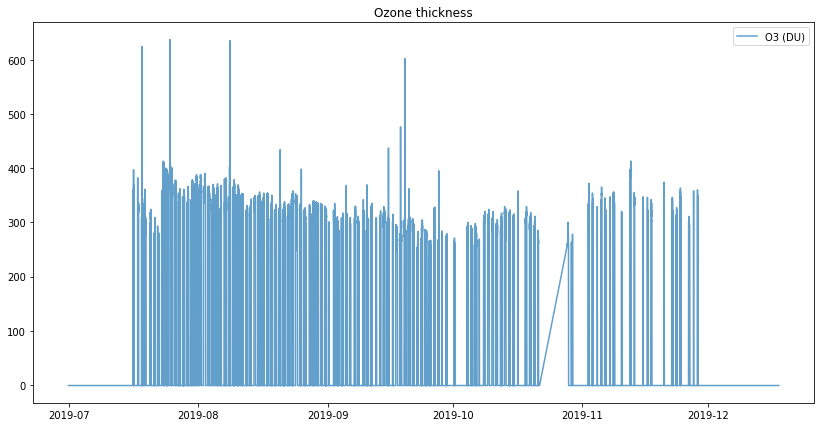

In [89]:
plot_large_df(df, ['O3 (DU)'], 'Ozone thickness')

In [90]:
oz_columns_orig = ['O3 (DU)']
oz_columns = ['O3']

df['O3 (DU)'] = [0 if i < 0 else i for i in df['O3 (DU)'].values]

hourly_df[oz_columns] = df[oz_columns_orig].resample('H').mean()

plotly_df(hourly_df, oz_columns, 'Ozone thickness (DU)')

In [91]:
daily_df['O3 max'] = hourly_df[oz_columns].resample('D').max()
#daily_df['O3 mean'] = hourly_df[oz_columns].resample('D').mean()

daily_oz_columns = ['O3 max']

plotly_df(daily_df, daily_oz_columns, 'Daily Ozone thickness (DU)')

It is obvious that the ozone layer can not drastically drop, it must be around the same level durng all measurement period. The drops in the data are caused by equipment mulfunction or by lack of irradiance. In case of week irradiance because of cloudy and rainy day, ozone level calculations could show mistakes. In case of equipment mulfunction, it is hard to say what caused the mistake. 

It can also be seen that the data from December is lost and November data has too many drops. In general, all drops must be deleted and the plot must be smoothed to get appropriate data. **Further data cleaning is required.** 
 
Comparison of ozone layer from external dataset will be performed in future.

## Summary of the data

### Meteorology

In [113]:
# Ambient Temperature
plotly_df(daily_df, ['WS600 Temperature', 'External Temperature'], 'Daily Temperature')

In [114]:
# Ambient Pressure
plotly_df(hourly_df, pressure_columns, 'Ambient Pressure')

In [115]:
# Ambient Humidity
plotly_df(hourly_df, humidity_columns, 'Ambient Humidity')

In [116]:
# Dew Point

plotly_df(hourly_df, dew_point_cols, 'Dew Point (hourly)')

In [117]:
# Wind Speed
plotly_df(hourly_df, wind_speed_cols, 'Wind Speed')

In [118]:
# Daily Precipitation
plotly_df(daily_df, precip_cols, 'Daily Precipitation (mm)')

### Spectral data

In [119]:
plotly_df(hourly_df, ghi_columns, 'Global Horizontal Irradiance (W/m2)')
plotly_df(daily_df, daily_ghi_columns, 'Daily GHI')

In [120]:
plotly_df(hourly_df, dhi_columns, 'Diffused Horizontal Irradiance (W/m2)')
plotly_df(daily_df, daily_dhi_columns, 'Daily DHI')

In [121]:
plotly_df(hourly_df, dni_columns, 'Direct Normal Irradiance (W/m2)')
plotly_df(daily_df, daily_dni_columns, 'Daily DNI')

In [122]:
plotly_df(hourly_df, gti_columns, 'Global Tilted Irradiance (W/m2)')
plotly_df(daily_df, daily_gti_columns, 'Daily GTI')

In [124]:
summary_columns = ['SMP21 GHI max', 'SMP21 DHI max', 'SHP1 DNI max', 'D2 DNI max', 'SMP21 GTI max'] 
plotly_df(daily_df, summary_columns, 'Daily Maximum Irradiance')

In [126]:
plotly_df(hourly_df, oz_columns, 'Ozone thickness (DU)')
plotly_df(daily_df, daily_oz_columns, 'Daily Ozone thickness (DU)')

In [127]:
plotly_df(daily_df, ['O3 max', 'D2 DNI max', 'SMP21 GHI max'])

### Save the dataframes

In [94]:
# Let's save preprocessed dataframes for futher analysis and forecasting
# 2 dataframes are saved : hourly and daily

hourly_df.to_csv('..\Data\hourly_data.csv')
daily_df.to_csv('..\Data\daily_data.csv')